In [5]:

from dask.distributed import Client
client = Client(scheduler_file='/proj/kimyy/Dropbox/source/python/all/mpi/scheduler.json')  
client

<Client: 'tcp://203.247.189.224:44420' processes=5 threads=90, memory=419.10 GiB>

In [8]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
#import pystuff as ps
import cartopy.crs as ccrs
import cartopy.feature as cf
import seaborn as sns
import matplotlib.patches as patches
from scipy import stats
import cmocean
import glob
#from cmcrameri import cm
#from tqdm.notebook import tqdm_notebook

In [9]:
import warnings
warnings.simplefilter(action='ignore')

In [15]:
ds = xr.open_mfdataset('/proj/shared_data/cesm_hires/r3600x1800/pd/PD_pd_mon_71-140.nc', parallel='True', decode_times=False)

In [ ]:
PD = ds.PD.isel(z_t=2).load()

In [13]:
# load variables at each periods 
t_scaling = xr.open_mfdataset('/proj/shared_data/awicm3/Paper/TCo1279/Code/Figure7/t_scaling.nc', parallel='True')#['t_scaling']
ws_scaling = xr.open_mfdataset('/proj/shared_data/awicm3/Paper/TCo1279/Code/Figure7/ws_scaling.nc', parallel='True')#['ws_scaling']
pr_scaling = xr.open_mfdataset('/proj/shared_data/awicm3/Paper/TCo1279/Code/Figure7/pr_scaling.nc', parallel='True')#['pr_scaling']

t_2000 = xr.open_mfdataset('/proj/shared_data/awicm3/Paper/TCo1279/Code/Figure7/t1279.2t.m.nc', parallel='True')#['2t']
ws_2000 = xr.open_mfdataset('/proj/shared_data/awicm3/Paper/TCo1279/Code/Figure7/t1279.10ws.m.nc', parallel='True')#['10ws']
pr_2000 = xr.open_mfdataset('/proj/shared_data/awicm3/Paper/TCo1279/Code/Figure7/t1279.pr.m.nc', parallel='True')#['pr']

OSError: no files to open

In [5]:
t_2000 = t_2000.squeeze() - 273.15
ws_2000 = ws_2000.squeeze()
pr_2000 = pr_2000.squeeze() * 8000

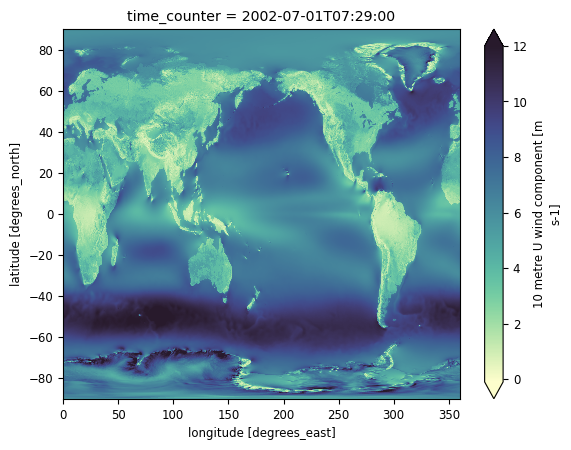

In [81]:
ws_2000.plot(vmax=0, vmin=12, cmap=cmocean.cm.deep)

  0%|          | 0/2 [00:00<?, ?it/s]

CPU times: user 47.9 s, sys: 2.84 s, total: 50.7 s
Wall time: 50.7 s


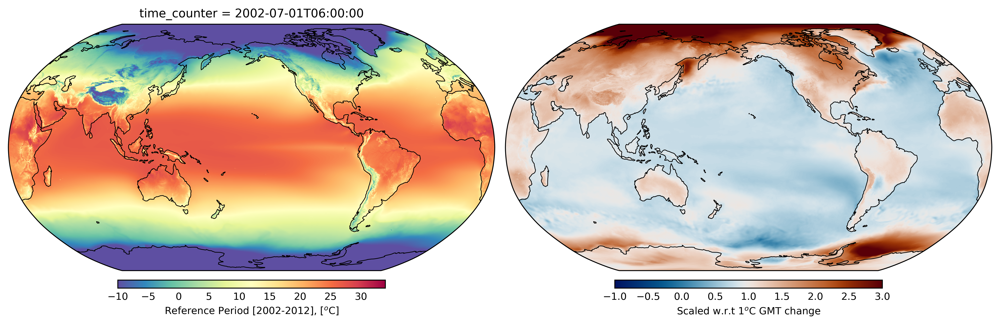

In [52]:
%%time
plt.rcParams.update({'font.size': 8.5})
fig,ax = plt.subplots(1,2,figsize=(18.5, 19), dpi=500, facecolor='w', edgecolor='k',subplot_kw={'projection': ccrs.Robinson(central_longitude=200)})

import cmocean
titlesM = ['Climatology', 'Normalized Signal']
titlesL = ['$\mathbf{a}$', '$\mathbf{b}$', '$\mathbf{c}$', '$\mathbf{d}$', '$\mathbf{e}$', '$\mathbf{f}$']
labels = ['2m Temperature', '10m Wind Speed', 'Precipitation']


fields=[ t_2000,  t_scaling]

# levels=[np.arange(-10,34,4),   np.arange(-1,3,0.2), 
#         np.arange(0,15,1), np.arange(-0.6,0.65,0.05),  
#         np.arange(0,20,1), np.arange(-1,1.05,0.05)]

vmins = [-10, -1]
vmaxs = [34, 3]


norms = [None, mcolors.TwoSlopeNorm(vmin=-1, vcenter=0, vmax=3)]

cbar=['Spectral_r', cm.vik]
#      cmocean.cm.deep, 'BrBG']
units=[ 'Reference Period [2002-2012], [$^{o}$C]', 'Scaled w.r.t 1$^{o}$C GMT change']

for i,a in enumerate(tqdm_notebook(ax.flat)) :
      clabel=('%s'%units[i])
      cbar_kwargs={'orientation':'horizontal','pad':0.01,'shrink':0.55, 'label':clabel, 'aspect':33, 'extend': 'neither'}
      c=fields[i].plot.pcolormesh(ax=a,transform=ccrs.PlateCarree(), vmin=vmins[i], vmax=vmaxs[i], cbar_kwargs=cbar_kwargs, cmap=cbar[i])
      c.colorbar.ax.tick_params(size=0)
      a.coastlines(linewidth=0.6,color='black')
      a.set_global()  

       
plt.tight_layout(rect=[0.3, 0.36, 0.95, 0.97])
#plt.savefig('/proj/shared_data/awicm3/Paper/TCo1279/Code/Figure7/Figure7.png',dpi=500, bbox_inches = 'tight')

  0%|          | 0/6 [00:00<?, ?it/s]

CPU times: user 4min 9s, sys: 17 s, total: 4min 26s
Wall time: 4min 26s


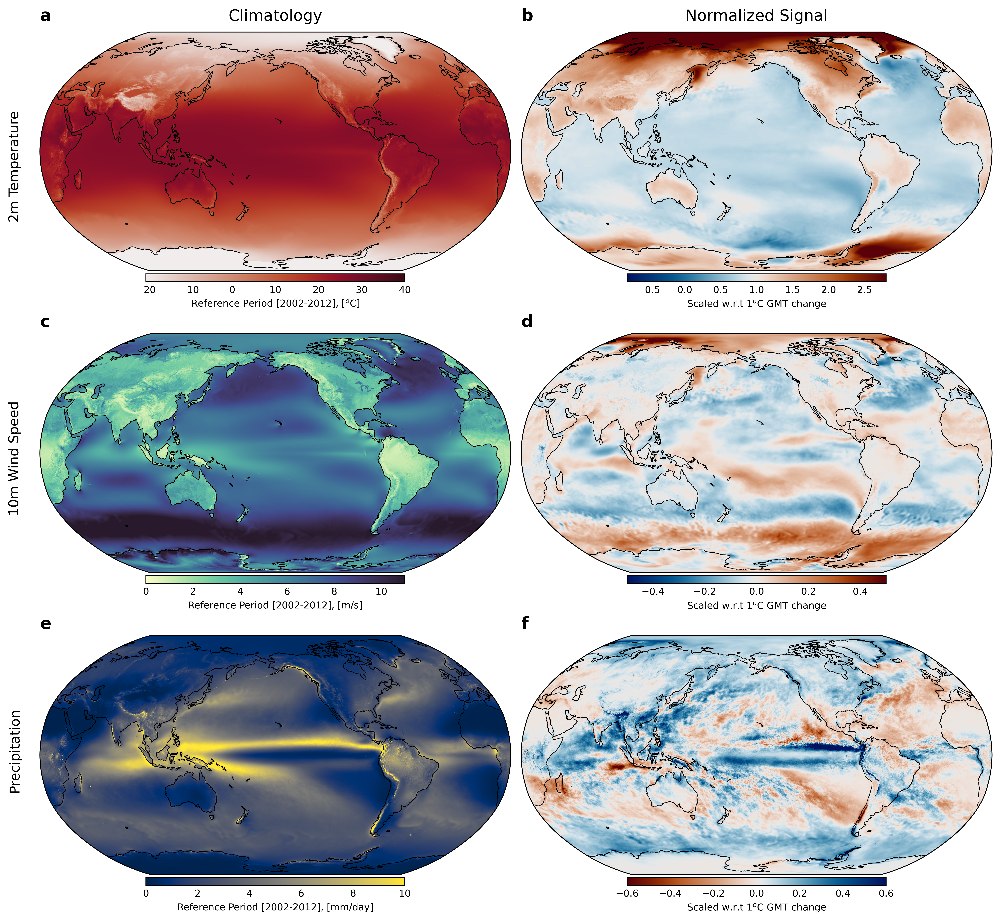

In [82]:
%%time
plt.rcParams.update({'font.size': 8.5})
fig,ax = plt.subplots(3,2,figsize=(18.5, 19), dpi=500, facecolor='w', edgecolor='k',subplot_kw={'projection': ccrs.Robinson(central_longitude=200)})

import cmocean
import matplotlib.colors as mcolors
titlesM = ['Climatology', 'Normalized Signal']
titlesL = ['$\mathbf{a}$', '$\mathbf{b}$', '$\mathbf{c}$', '$\mathbf{d}$', '$\mathbf{e}$', '$\mathbf{f}$']
labels = ['2m Temperature', '10m Wind Speed', 'Precipitation']


fields=[ t_2000,  t_scaling, 
         ws_2000, ws_scaling,  
         pr_2000, pr_scaling]

# levels=[np.arange(-10,34,4),   np.arange(-1,3,0.2), 
#         np.arange(0,15,1), np.arange(-0.6,0.65,0.05),  
#         np.arange(0,20,1), np.arange(-1,1.05,0.05)]

vmins = [-20, -0.8, 0, -0.5, 0, -0.6]
vmaxs = [40, 2.8, 11, 0.5, 10, 0.6]


cbar=[cmocean.cm.amp, cm.vik,
      cmocean.cm.deep, cm.vik,   
      'cividis', cm.vik_r]
#      cmocean.cm.deep, 'BrBG']
units=[ 'Reference Period [2002-2012], [$^{o}$C]', 'Scaled w.r.t 1$^{o}$C GMT change',
        'Reference Period [2002-2012], [m/s]', 'Scaled w.r.t 1$^{o}$C GMT change', 
        'Reference Period [2002-2012], [mm/day]', 'Scaled w.r.t 1$^{o}$C GMT change']

for i,a in enumerate(tqdm_notebook(ax.flat)) :
      clabel=('%s'%units[i])
      cbar_kwargs={'orientation':'horizontal','pad':0.01,'shrink':0.55, 'label':clabel, 'aspect':33, 'extend': 'neither'}
      c=fields[i].plot.pcolormesh(ax=a,transform=ccrs.PlateCarree(),vmin=vmins[i], vmax=vmaxs[i], cbar_kwargs=cbar_kwargs,cmap=cbar[i])
      c.colorbar.ax.tick_params(size=0)
      a.coastlines(linewidth=0.6,color='black')
      a.set_global()  

for i, label in enumerate(labels):
    fig.text(0.29, 0.86 - i * 0.19, label, transform=fig.transFigure, fontsize=12, va='center', ha='center', rotation=90)
   
for i, a in enumerate(ax.flat):
    a.set_title('%s' % titlesL[i], size=15, loc='left')

    if i <= 1:
        a.set_title('%s' % (titlesM[i]), size=14, y=1.0, pad=10)
    else:
        a.set_title('')
            
plt.tight_layout(rect=[0.3, 0.36, 0.95, 0.97])
plt.savefig('/proj//sahils/scripts/python/awi_presentation_paper/updated_final_plots_pcolor/Figure7_updated.png',dpi=500, bbox_inches = 'tight')